In [1]:
import pandas as pd
import plotly.express as px
import seaborn as sns

In [2]:
sun = pd.read_csv("../data/SN_d_tot_V2.0.csv", sep=';')
sun.columns = ['Year', 'Month', 'Day', 'Fractional Date', 'SunSpot Count', "DailyStDev", "Observations", 'Indicator']
# sun

### Let's clean this up a bit by:

 + Combing Year Month and Day
 + Convert that to a pandas DateTime object
 + Set that as the index since they are inorder and unique
 + Delete Year Month and Day columns
 
### So, from nine columns (including the index) to <strike>six</strike> five.<br>
'Fractional Date' removed for display purposes

In [3]:
sun['Date'] = sun['Year'].map(str)+ '-' + sun['Month'].map(str) + '-' + sun['Day'].map(str)
sun.index = pd.to_datetime(sun['Date'], utc=False)
sun = sun[['Date', 'SunSpot Count', 'DailyStDev', 'Observations', 'Indicator'] ] 
sun.drop('Date', axis=1, inplace=True)
sun.head(2)

,SunSpot Count,DailyStDev,Observations,Indicator
Date,,,,
1818-01-02,-1,-1.0,0,1
1818-01-03,-1,-1.0,0,1


### If I make this into a website, I might have a field to look up the # on a given day

In [4]:
sun.loc['1935-03-28']

#March 28 1935

SunSpot Count    0.0
DailyStDev       2.0
Observations     1.0
Indicator        1.0
Name: 1935-03-28 00:00:00, dtype: float64

In [5]:
sun.loc['1969-10-04']

SunSpot Count    140.0
DailyStDev         7.9
Observations       1.0
Indicator          1.0
Name: 1969-10-04 00:00:00, dtype: float64

### Daily is probably a bit busy for a chart of two hundred years so let's try some different timescales

In [6]:
yearly = sun.groupby(pd.Grouper(freq='Y')).sum()

In [7]:
px.line(yearly)

## let's do a couple of comparison charts with seaborn

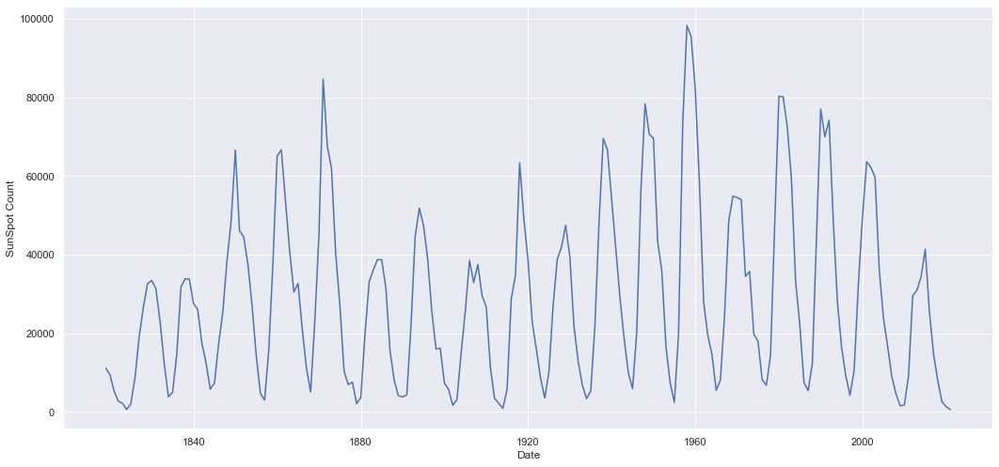

In [25]:
sns.set(rc={'figure.figsize':(17.7,8.27)})
sns.lineplot(x='Date', y='SunSpot Count', data=yearly)

In [11]:
# quarterly = sun.groupby(pd.Grouper(freq='Q')).sum()
# px.line(quarterly)

In [12]:
# monthly = sun.groupby(pd.Grouper(freq='M')).sum()
# px.line(monthly)

In [26]:
monthly = sun.groupby(pd.Grouper(freq='M')).sum()
px.line(sun)

Still need to figure out the details om the legends

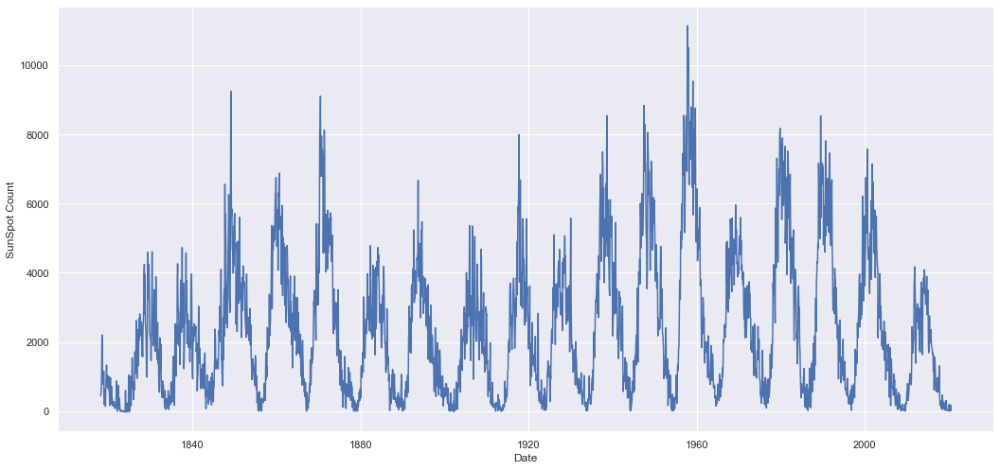

In [27]:
sns.set(rc={'figure.figsize':(17.7,8.27)})
sns.lineplot(x='Date', y='SunSpot Count', data=monthly)

The plots are much quicker with seaborn. But more is being plotted with PX. Also, PX is interacitve.